## I.  Fully Convolutional One-Stage Object Detection

The FCOS model is based on the [FCOS: Fully Convolutional One-Stage Object Detection](https://arxiv.org/abs/1904.01355) paper.



In [31]:
# Note that this script was pulled from here: https://pytorch.org/vision/main/models#object-detection
# Imports
from torchvision.io.image import read_image
import torchvision
import os

# Explore the torchvision documentation to apply the other models and their weights
from torchvision.models.detection import fcos_resnet50_fpn, FCOS_ResNet50_FPN_Weights
from torchvision.utils import draw_bounding_boxes
from torchvision.transforms.functional import to_pil_image
from IPython.display import display

from PIL import ImageFont, ImageDraw
from PIL import Image, ImageDraw, ImageFont



In [5]:
# Reading in a sample image from the `America` image folder from the Free to Reuse Data Package
img = read_image("../images/image_2016883798.jpg")

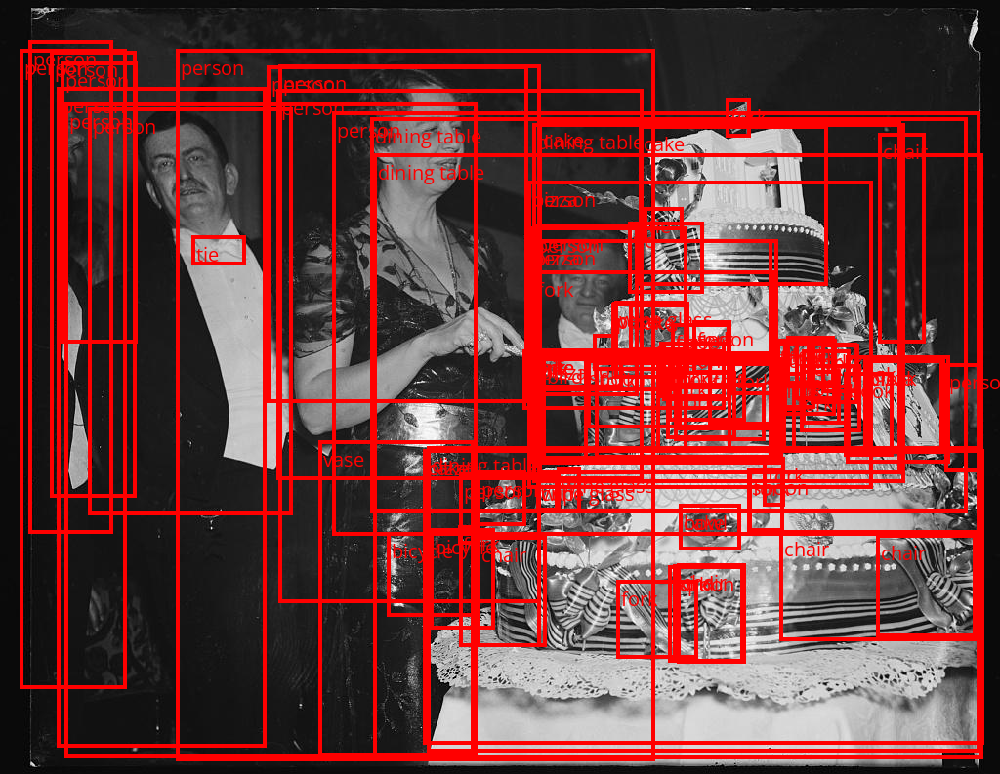

In [6]:
# Step 1: Initialize model with the best available weights
weights = FCOS_ResNet50_FPN_Weights.DEFAULT
model = torchvision.models.detection.fcos_resnet50_fpn(weights=weights)
model.eval()

# Step 2: Initialize the inference transforms
preprocess = weights.transforms()

# Step 3: Apply inference preprocessing transforms
batch = [preprocess(img)]

# Step 4: Use the model and visualize the prediction
prediction = model(batch)[0]
labels = [weights.meta["categories"][i] for i in prediction["labels"]]
font_path = os.path.abspath("../fonts/OpenSans-Regular.ttf")

box = draw_bounding_boxes(
    img, boxes=prediction["boxes"], font=font_path, labels=labels, colors="red", width=4, font_size=20
)
im = to_pil_image(box.detach())
# im.show()

# Displays the Image
display(im)

### V. Experimentation

Use images from the _images/_ folder to test the model's performance and test out different box_score_thresholds.

In [16]:
def object_detection(image_path, threshold=0.9):
    image_path = '../' + image_path
    img = read_image(image_path)
    weights = FCOS_ResNet50_FPN_Weights.DEFAULT
    model = torchvision.models.detection.fcos_resnet50_fpn(weights=weights)
    model.eval()

    # Step 2: Initialize the inference transforms
    preprocess = weights.transforms()

    # Step 3: Apply inference preprocessing transforms
    batch = [preprocess(img)]

    # Step 4: Use the model and visualize the prediction
    font_path = os.path.abspath("../fonts/OpenSans-Regular.ttf")

    prediction = model(batch)[0]

    if len(prediction) == 0:
        print(
            f"No Objects within the Scope of the MS COCO Dataset found in {image_path}"
        )
    else:
        print(
            f"Objects within the Scope of the MS COCO Dataset found in {image_path}"
        )
        labels = [weights.meta["categories"][i] for i in prediction["labels"]]
        box = draw_bounding_boxes(
            img,
            boxes=prediction["boxes"],
            labels=labels,
            colors="red",
            font=font_path,
            width=4,
            font_size=25,
        )
        im = to_pil_image(box.detach())
        # im.show()

        # Displays the Image
        display(im)

In [33]:
def object_detection(model, weights, image_path, threshold=0.90):
    image_path = '../' + image_path

    img = read_image(image_path)
    # Step 1: Initialize model with the best available weights
    weights = weights.DEFAULT
    model_name = model.__name__

    model = model(weights=weights)
    model.eval()

    # Step 2: Initialize the inference transforms
    preprocess = weights.transforms()

    # Step 3: Apply inference preprocessing transforms
    batch = [preprocess(img)]

    # Step 4: Use the model and visualize the prediction
    prediction = model(batch)[0]

    # Extracting the len of Index of the scores that meet the threshold value:
    score_len = (prediction["scores"] >= threshold).sum().item()
    # Limits the scores at the threshold to just the top 5
    if score_len >= 5:
        score_len = 5
    else:
        score_len = score_len
    # Step 5: Visualizing Model predictions onto image.

    # Annotation features
    image_heading = f"Evaluating Top Detections\n{model_name}: {score_len} detections at {threshold}"
    fill = (57, 255, 20)
    font_path = os.path.abspath("../fonts/OpenSans-Regular.ttf")
    font = ImageFont.truetype(font_path, 30)

    if score_len == 0:  # If there are no predictions at the threshold, just o
        im = to_pil_image(img)
        draw = ImageDraw.Draw(im)
        draw.text((5, 5), image_heading, font=font, fill=fill, align="left")
        display(im)

    else:  # If there are predictions, generate annotated visualization and save to corresponding output directory
        labels = [
            weights.meta["categories"][i] for i in prediction["labels"][:score_len]
        ]
        scores = prediction["scores"][:score_len]
        labels_with_scores = [
            f"{label} {score:.2f}" for label, score in zip(labels, scores)
        ]

        box = draw_bounding_boxes(
            img,
            boxes=prediction["boxes"][:score_len],
            labels=labels_with_scores,
            colors="red",
            width=4,
            font=font_path,
            font_size=20,
        )
        im = to_pil_image(box.detach())

        # Draw the model name at the top left of the image
        draw = ImageDraw.Draw(im)
        draw.text((5, 5), image_heading, font=font, fill=fill, align="left")
        display(im)

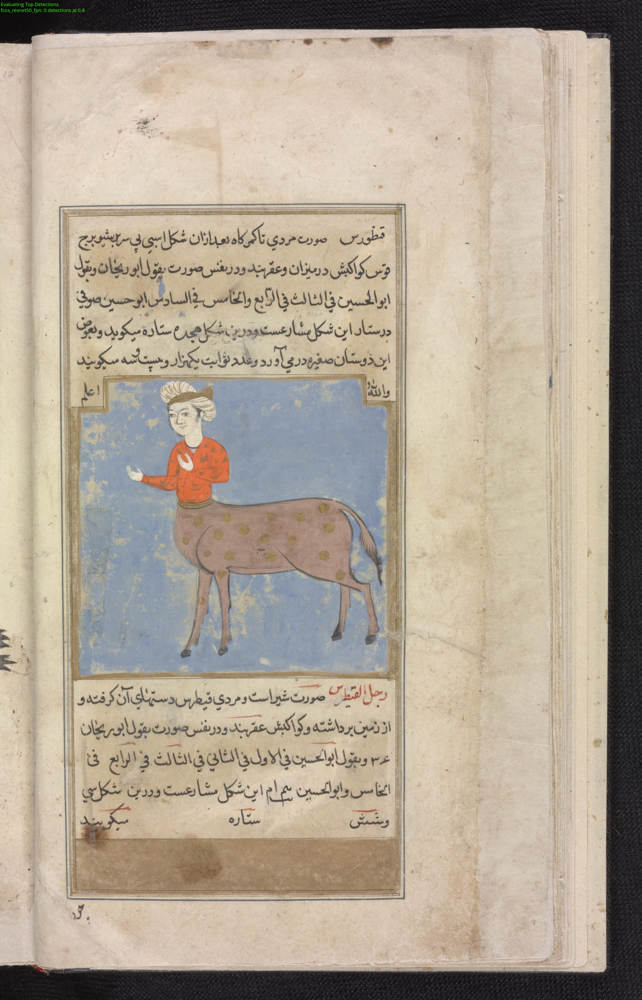

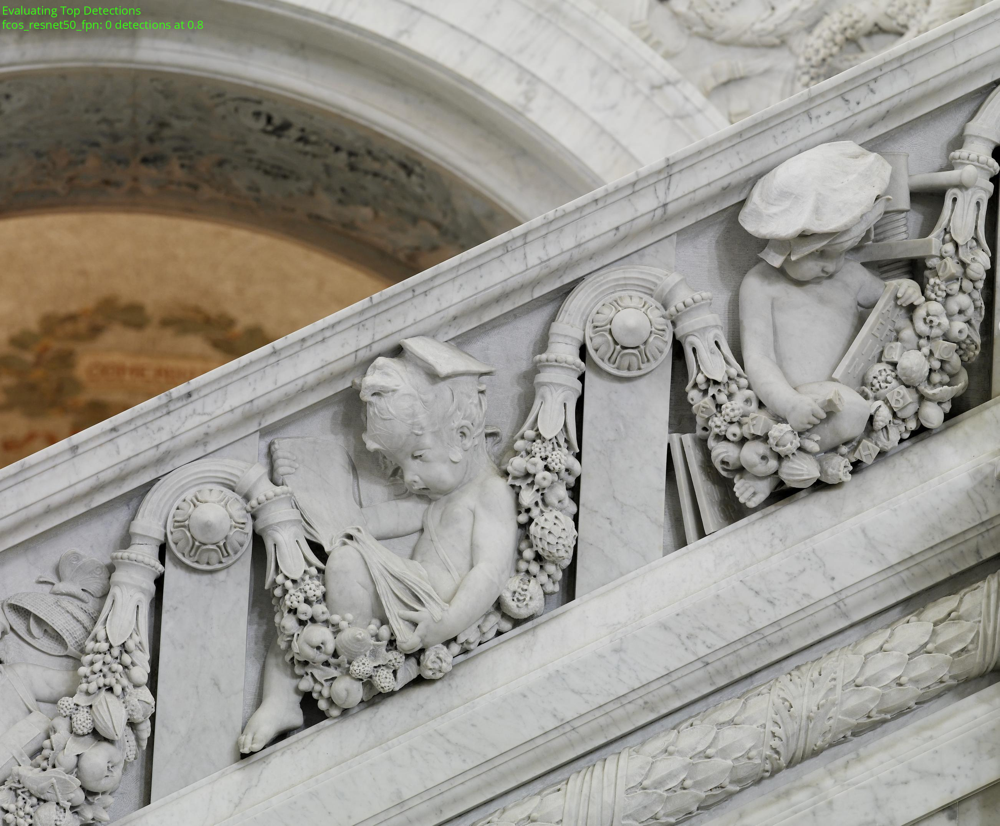

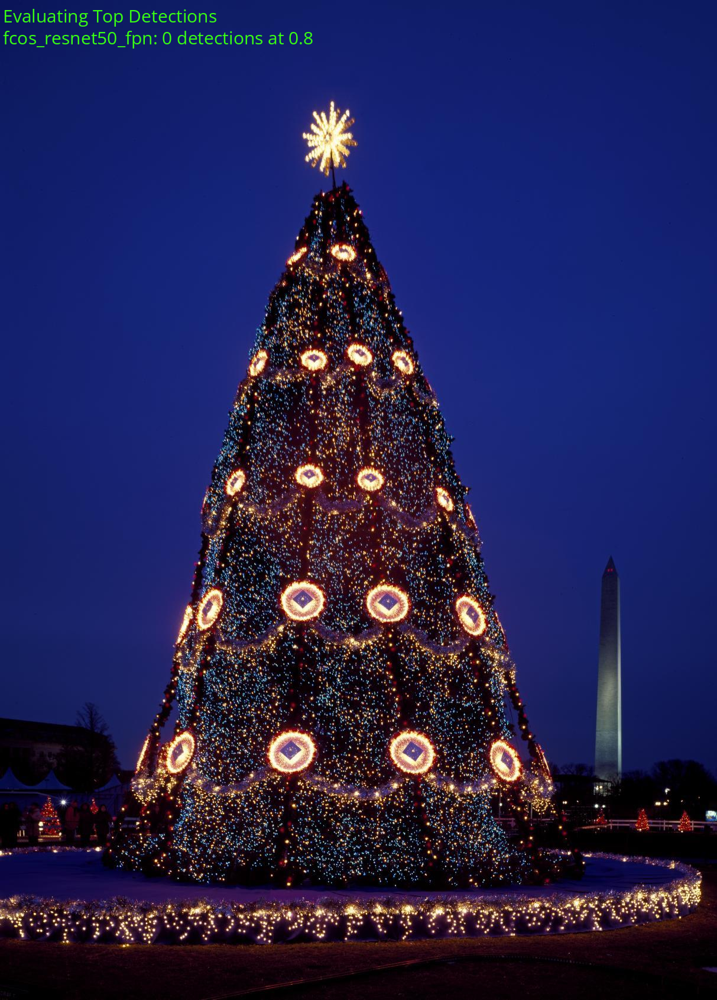

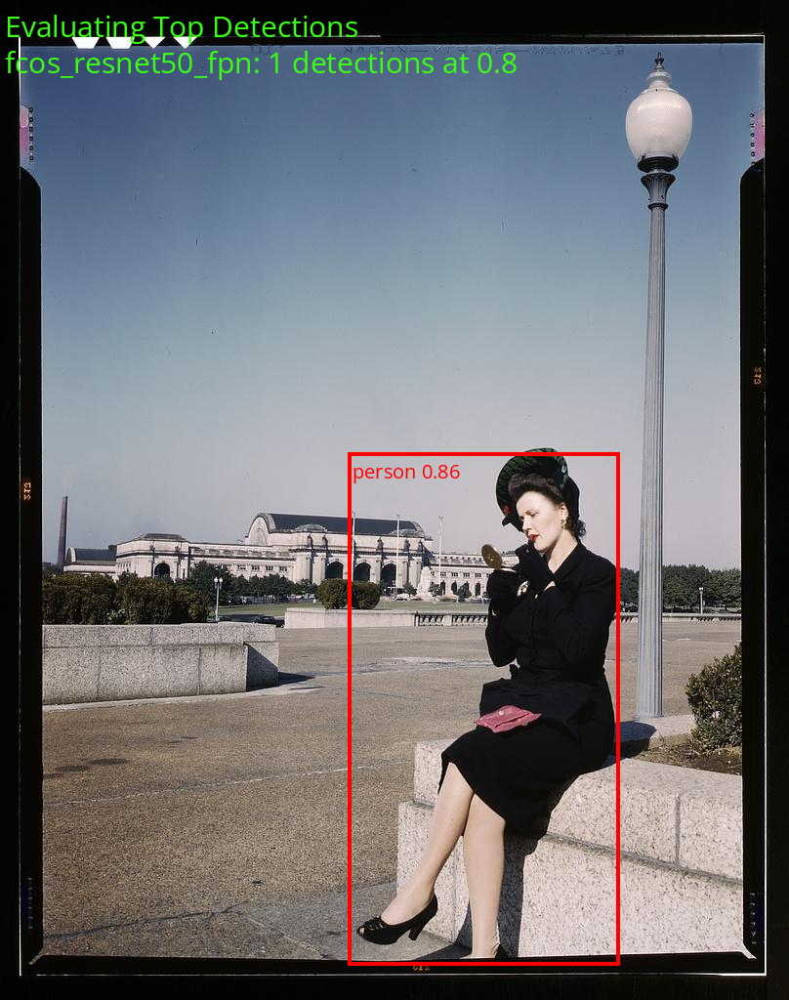

In [35]:
for image in os.listdir('../images')[:4]:
    image_path = 'images/' + image
    object_detection(fcos_resnet50_fpn, FCOS_ResNet50_FPN_Weights, image_path, threshold = 0.8)
